Found 24 JSON files
Loaded 24 data points

Plot saved to: ../docs/metrics.png



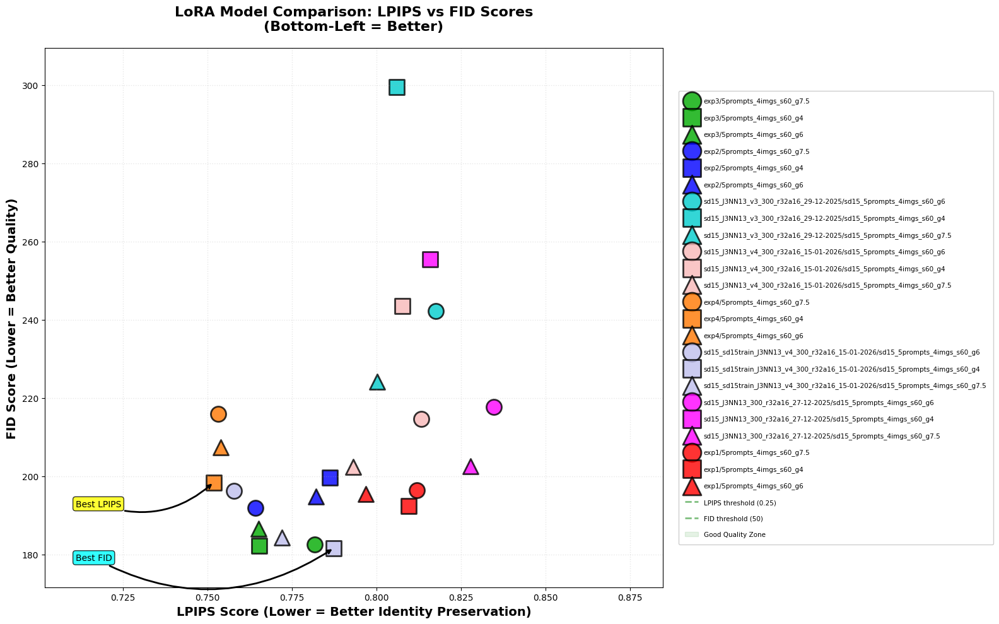

                          SUMMARY STATISTICS                          
Total models evaluated: 24

Best LPIPS (identity preservation): 0.7518
  → exp4/5prompts_4imgs_s60_g4

Best FID (overall quality): 181.5783
  → sd15_sd15train_J3NN13_v4_300_r32a16_15-01-2026/sd15_5prompts_4imgs_s60_g4

Worst LPIPS: 0.8348
Worst FID: 299.4979

DETAILED RESULTS (sorted by FID):
Model                                                                  LPIPS        FID
------------------------------------------------------------------------------------------
sd15_sd15train_J3NN13_v4_300_r32a16_15-01-2026/sd15_5prompts_4imgs_s60_g4     0.7873 181.58    
exp3/5prompts_4imgs_s60_g4                                            0.7652 182.17    
exp3/5prompts_4imgs_s60_g7.5                                          0.7816 182.50    
sd15_sd15train_J3NN13_v4_300_r32a16_15-01-2026/sd15_5prompts_4imgs_s60_g7.5     0.7721 184.23    
exp3/5prompts_4imgs_s60_g6                                            0.7651 186.58   

In [2]:
import json
import matplotlib.pyplot as plt
from pathlib import Path
import numpy as np

import warnings
warnings.filterwarnings("ignore", category=UserWarning)

# Scan all JSON files in metrics directory
metrics_dir = Path("/home/duchieuvn/Downloads/sdf-copy/metrics")
json_files = list(metrics_dir.rglob("evaluation_metrics.json"))

print(f"Found {len(json_files)} JSON files")

# Extract data
data = []
for json_file in json_files:
    with open(json_file, 'r') as f:
        metrics = json.load(f)
        
        # Extract model info from path
        parts = json_file.parts
        model_name = parts[-3]  # e.g., "J3NN13_300_r32a16_27-12-2025"
        config = parts[-2]  # e.g., "5prompts_4imgs_s60_g7.5"
        
        # Use full folder name as label
        label = f"{model_name}/{config}"
        
        data.append({
            'lpips': metrics['lpips']['score'],
            'fid': metrics['fid']['score'],
            'label': label,
            'model': model_name,
            'config': config
        })

print(f"Loaded {len(data)} data points\n")

# Create scatter plot
fig, ax = plt.subplots(figsize=(16, 10))

# Define clearly different colors for each parent folder
unique_models = sorted(set(d['model'] for d in data))
colors_list = [
    '#FF0000', '#0000FF', '#00AA00', '#FF7700', '#FF00FF', '#00CCCC',
    "#F8B8B8", "#BEBEED", '#00CC00', '#FF4400', '#CC00CC', '#00AAAA',
    '#990000', "#010120", '#009900', '#CC8800', '#990099', '#009999',
]
model_colors = {model: colors_list[i % len(colors_list)] for i, model in enumerate(unique_models)}

# Use only 3 marker shapes
markers_list = ['o', 's', '^']

# Plot each point with unique styling
plotted_labels = set()
for i, d in enumerate(data):
    color = model_colors[d['model']]  # Color based on parent folder
    marker = markers_list[i % len(markers_list)]  # Cycle through 3 markers
    
    # Only add label if not already plotted (for legend)
    if d['label'] not in plotted_labels:
        ax.scatter(d['lpips'], d['fid'], 
                   c=[color], marker=marker, s=300, 
                   alpha=0.8, edgecolors='black', linewidth=2,
                   label=d['label'])
        plotted_labels.add(d['label'])
    else:
        ax.scatter(d['lpips'], d['fid'], 
                   c=[color], marker=marker, s=300, 
                   alpha=0.8, edgecolors='black', linewidth=2)

# Add reference lines for good quality thresholds
ax.axvline(x=0.25, color='green', linestyle='--', alpha=0.5, linewidth=2, 
           label='LPIPS threshold (0.25)')
ax.axhline(y=50, color='green', linestyle='--', alpha=0.5, linewidth=2, 
           label='FID threshold (50)')

# Add quality zones (lower is better - bottom-left is good)
ax.fill_between([0, 0.25], 0, 50, alpha=0.1, color='green', 
                label='Good Quality Zone')

# Labels and title
ax.set_xlabel('LPIPS Score (Lower = Better Identity Preservation)', fontsize=14, fontweight='bold')
ax.set_ylabel('FID Score (Lower = Better Quality)', fontsize=14, fontweight='bold')
ax.set_title('LoRA Model Comparison: LPIPS vs FID Scores\n(Bottom-Left = Better)', fontsize=16, fontweight='bold', pad=20)

# Grid
ax.grid(True, alpha=0.3, linestyle=':', linewidth=1)

# Set axis limits with some padding
lpips_values = [d['lpips'] for d in data]
fid_values = [d['fid'] for d in data]
ax.set_xlim(min(lpips_values) - 0.05, max(lpips_values) + 0.05)
ax.set_ylim(min(fid_values) - 10, max(fid_values) + 10)

# Add annotations for best models at bottom left with arrows
best_lpips_idx = np.argmin(lpips_values)
best_fid_idx = np.argmin(fid_values)

# Best LPIPS annotation - arrow pointing to the point
ax.annotate('Best LPIPS', 
            xy=(data[best_lpips_idx]['lpips'], data[best_lpips_idx]['fid']),
            xytext=(0.05, 0.15), textcoords='axes fraction',
            bbox=dict(boxstyle='round', facecolor='yellow', alpha=0.8),
            arrowprops=dict(arrowstyle='->', connectionstyle='arc3,rad=0.3', lw=2, color='black'))

# Best FID annotation - arrow pointing to the point
ax.annotate('Best FID', 
            xy=(data[best_fid_idx]['lpips'], data[best_fid_idx]['fid']),
            xytext=(0.05, 0.05), textcoords='axes fraction',
            bbox=dict(boxstyle='round', facecolor='cyan', alpha=0.8),
            arrowprops=dict(arrowstyle='->', connectionstyle='arc3,rad=0.3', lw=2, color='black'))

# Legend with better formatting - moved outside with more spacing
ax.legend(loc='center left', fontsize=7.5, framealpha=0.95, ncol=1, 
          markerscale=1.2, bbox_to_anchor=(1.02, 0.5), 
          labelspacing=1.5, borderpad=1)

plt.tight_layout()

# Save plot
output_path = "../docs/metrics.png"
plt.savefig(output_path, dpi=300, bbox_inches='tight')
print(f"Plot saved to: {output_path}\n")

# Show plot
plt.show()

# Print summary statistics
print("=" * 70)
print("SUMMARY STATISTICS".center(70))
print("=" * 70)
print(f"Total models evaluated: {len(data)}")
print(f"\nBest LPIPS (identity preservation): {min(lpips_values):.4f}")
print(f"  → {data[best_lpips_idx]['label']}")
print(f"\nBest FID (overall quality): {min(fid_values):.4f}")
print(f"  → {data[best_fid_idx]['label']}")
print(f"\nWorst LPIPS: {max(lpips_values):.4f}")
print(f"Worst FID: {max(fid_values):.4f}")
print("=" * 70)

# Print detailed table
print("\nDETAILED RESULTS (sorted by FID):")
print(f"{'Model':<65} {'LPIPS':>10} {'FID':>10}")
print("-" * 90)
for d in sorted(data, key=lambda x: x['fid']):
    print(f"{d['label']:<65} {d['lpips']:>10.4f} {d['fid']:<10.2f}")
    


exp1: Found 60 images
Saved plot: /home/duchieuvn/Downloads/sdf-copy/testgen/exp1_preview.png


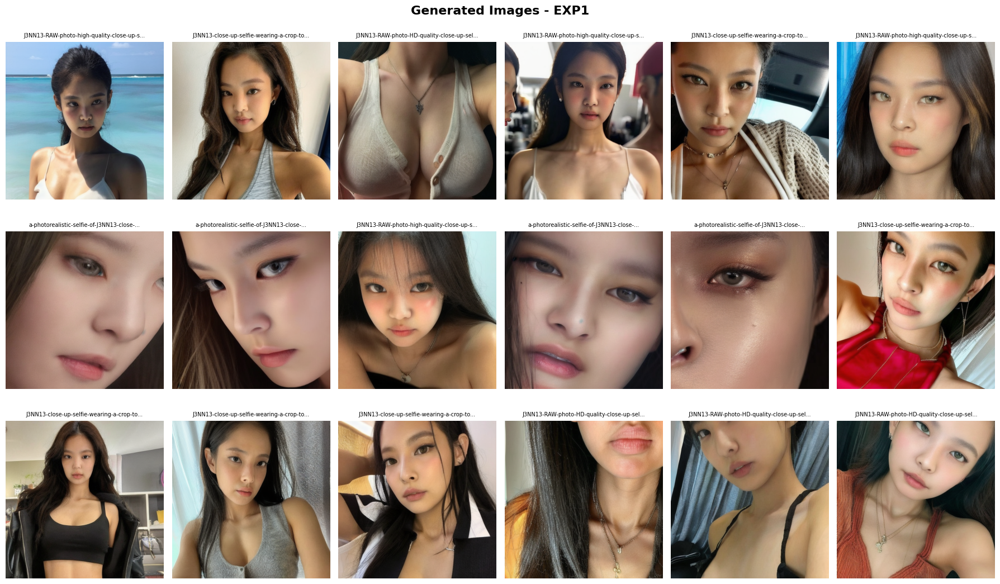


exp2: Found 60 images
Saved plot: /home/duchieuvn/Downloads/sdf-copy/testgen/exp2_preview.png


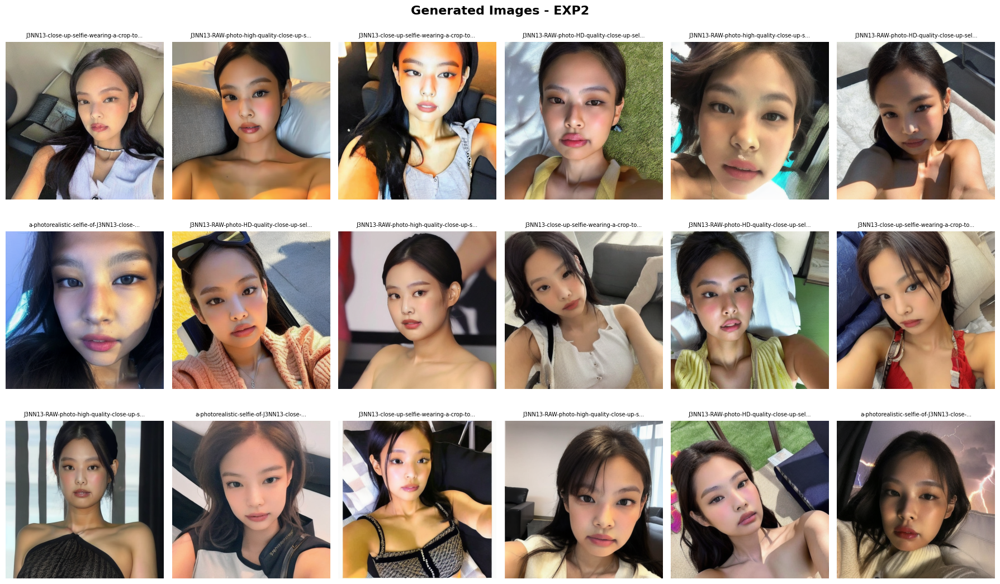


exp3: Found 60 images
Saved plot: /home/duchieuvn/Downloads/sdf-copy/testgen/exp3_preview.png


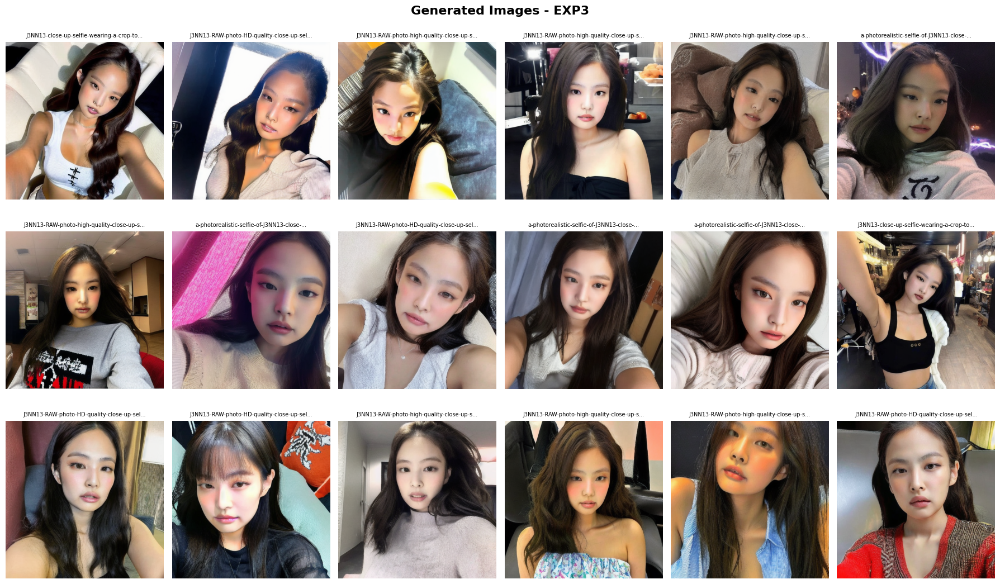


exp4: Found 60 images
Saved plot: /home/duchieuvn/Downloads/sdf-copy/testgen/exp4_preview.png


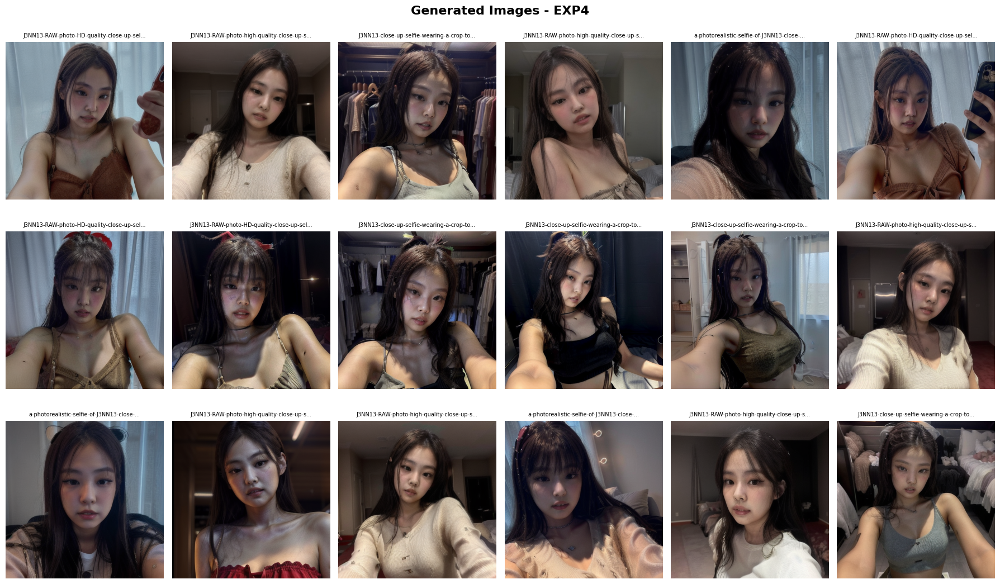


✓ All preview plots generated successfully!


In [5]:
import os
import glob
import random
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np

# Path to testgen directory
testgen_path = "/home/duchieuvn/Downloads/sdf-copy/testgen"

# Plot configuration
num_row = 3
num_col = 6
total_cells = num_row * num_col

# Experiment folders to process
exp_folders = ["exp1", "exp2", "exp3", "exp4"]

# Create plots for each experiment
for exp_name in exp_folders:
    exp_path = os.path.join(testgen_path, exp_name)
    
    # Get all image files recursively
    image_files = glob.glob(os.path.join(exp_path, "**", "*.png"), recursive=True)
    image_files += glob.glob(os.path.join(exp_path, "**", "*.jpg"), recursive=True)
    image_files += glob.glob(os.path.join(exp_path, "**", "*.jpeg"), recursive=True)
    
    print(f"\n{exp_name}: Found {len(image_files)} images")
    
    if len(image_files) == 0:
        print(f"No images found in {exp_path}")
        continue
    
    # Randomly select up to total_cells images
    num_images = min(total_cells, len(image_files))
    selected_images = random.sample(image_files, num_images)
    
    # Create figure with num_row rows and num_col columns
    fig, axes = plt.subplots(num_row, num_col, figsize=(18, 11))
    fig.suptitle(f"Generated Images - {exp_name.upper()}", fontsize=16, fontweight='bold')
    
    # Flatten axes for easier iteration
    axes = axes.flatten()
    
    # Display selected images
    for idx, img_path in enumerate(selected_images):
        try:
            img = Image.open(img_path)
            axes[idx].imshow(img)
            axes[idx].axis('off')
            # Get just filename for title
            basename = os.path.basename(img_path)
            axes[idx].set_title(basename[:40] + "..." if len(basename) > 40 else basename, fontsize=7)
        except Exception as e:
            print(f"Error loading {img_path}: {e}")
            axes[idx].axis('off')
    
    # Hide unused subplots
    for idx in range(num_images, total_cells):
        axes[idx].axis('off')
    
    plt.tight_layout()
    output_path = f"/home/duchieuvn/Downloads/sdf-copy/testgen/{exp_name}_preview.png"
    plt.savefig(output_path, dpi=100, bbox_inches='tight')
    print(f"Saved plot: {output_path}")
    plt.show()

print("\n✓ All preview plots generated successfully!")


exp1: Found 23 images
Saved plot: /home/duchieuvn/Downloads/sdf-copy/docs/asset/exp1_best.png


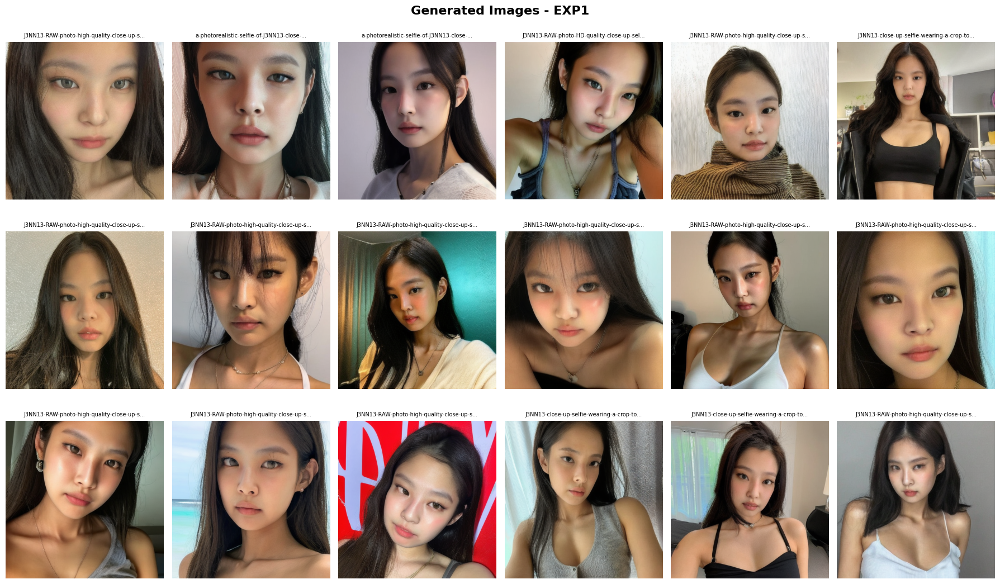


exp2: Found 42 images
Saved plot: /home/duchieuvn/Downloads/sdf-copy/docs/asset/exp2_best.png


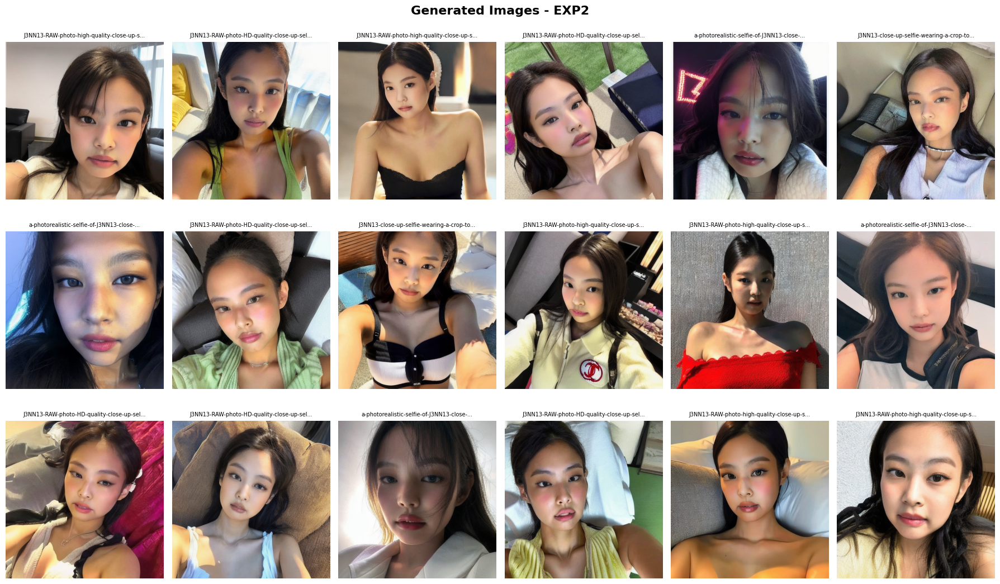


exp3: Found 60 images
Saved plot: /home/duchieuvn/Downloads/sdf-copy/docs/asset/exp3_best.png


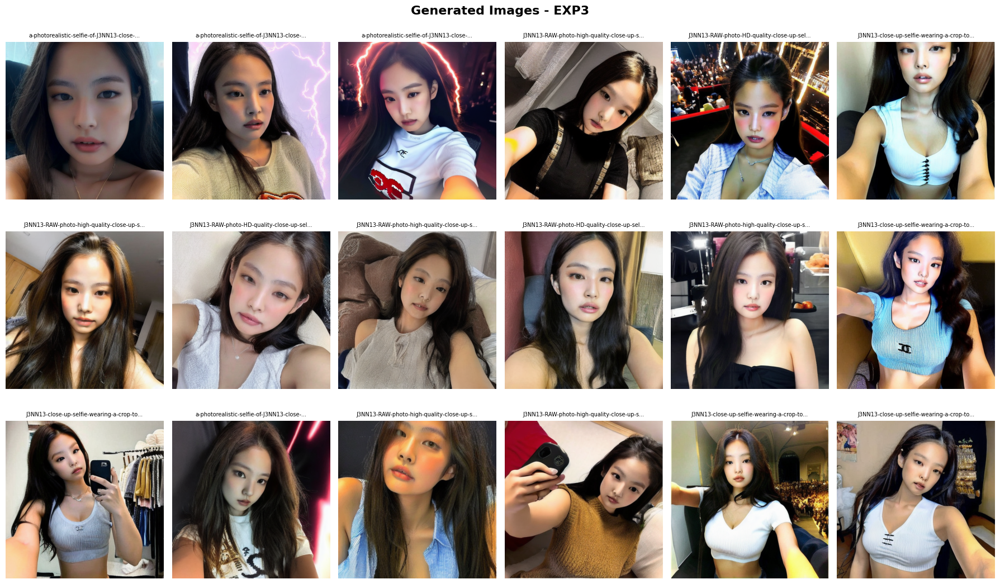


exp4: Found 36 images
Saved plot: /home/duchieuvn/Downloads/sdf-copy/docs/asset/exp4_best.png


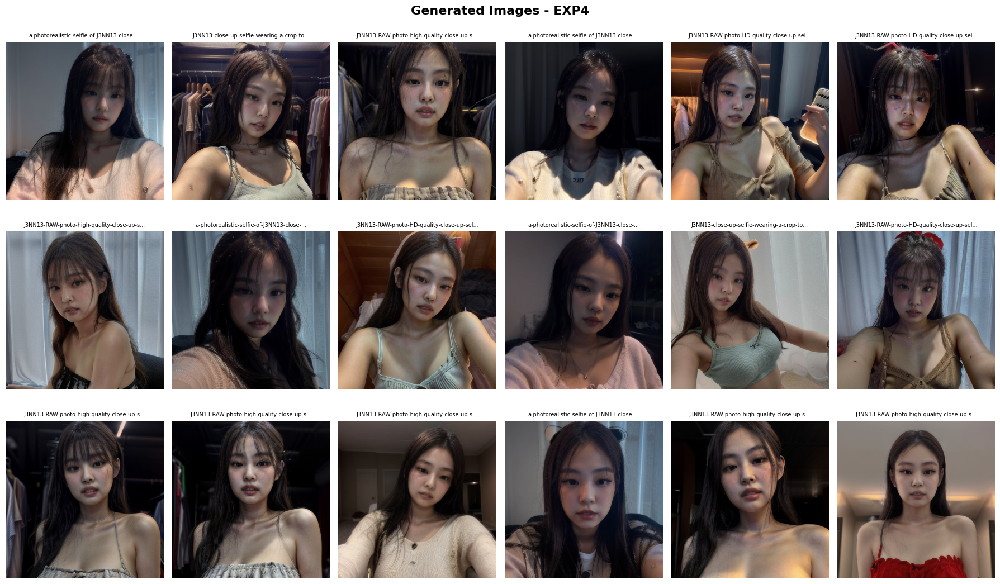


✓ All preview plots generated successfully!


In [7]:
import os
import glob
import random
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np

# Path to testgen directory
testgen_path = "/home/duchieuvn/Downloads/sdf-copy/docs/asset/"

# Plot configuration
num_row = 3
num_col = 6
total_cells = num_row * num_col

# Experiment folders to process
exp_folders = ["exp1", "exp2", "exp3", "exp4"]

# Create plots for each experiment
for exp_name in exp_folders:
    exp_path = os.path.join(testgen_path, exp_name)
    
    # Get all image files recursively
    image_files = glob.glob(os.path.join(exp_path, "**", "*.png"), recursive=True)
    image_files += glob.glob(os.path.join(exp_path, "**", "*.jpg"), recursive=True)
    image_files += glob.glob(os.path.join(exp_path, "**", "*.jpeg"), recursive=True)
    
    print(f"\n{exp_name}: Found {len(image_files)} images")
    
    if len(image_files) == 0:
        print(f"No images found in {exp_path}")
        continue
    
    # Randomly select up to total_cells images
    num_images = min(total_cells, len(image_files))
    selected_images = random.sample(image_files, num_images)
    
    # Create figure with num_row rows and num_col columns
    fig, axes = plt.subplots(num_row, num_col, figsize=(18, 11))
    fig.suptitle(f"Generated Images - {exp_name.upper()}", fontsize=16, fontweight='bold')
    
    # Flatten axes for easier iteration
    axes = axes.flatten()
    
    # Display selected images
    for idx, img_path in enumerate(selected_images):
        try:
            img = Image.open(img_path)
            axes[idx].imshow(img)
            axes[idx].axis('off')
            # Get just filename for title
            basename = os.path.basename(img_path)
            axes[idx].set_title(basename[:40] + "..." if len(basename) > 40 else basename, fontsize=7)
        except Exception as e:
            print(f"Error loading {img_path}: {e}")
            axes[idx].axis('off')
    
    # Hide unused subplots
    for idx in range(num_images, total_cells):
        axes[idx].axis('off')
    
    plt.tight_layout()
    output_path = f"/home/duchieuvn/Downloads/sdf-copy/docs/asset/{exp_name}_best.png"
    plt.savefig(output_path, dpi=100, bbox_inches='tight')
    print(f"Saved plot: {output_path}")
    plt.show()

print("\n✓ All preview plots generated successfully!")